## Load Labels to see if Boarders align with Chaos Regions (Optional, but highly recommended when starting)

In [2]:
from PIL import Image
from collections import Counter
Image.MAX_IMAGE_PIXELS = 1000000000 

In [4]:
#image file
img = Image.open("./LabelMe_files/PNG RegMaps/data_annotated/val/c17ESNERTRM01_GalileoSSI_E.png")
img.size

(1941, 7092)

In [16]:
#Image file
#210m/pixel
img = Image.open("./LabelMe_files/PNG RegMaps/data_dataset_voc/SegmentationObjectPNG/val/c17ESNERTRM01_GalileoSSI_E.png")
left = 800
top = 5225
right = 1725
bottom = 6500

# Crop if necessary 
im = img.crop((left, top, right, bottom))
im
#im.save("./LabelMe_files/PNG RegMaps/data_annotated/val/Europa_Chaos_hh-kk.png")
im.save("./LabelMe_files/PNG RegMaps/data_dataset_voc/SegmentationObjectPNG/val/Europa_Chaos_hh-kk.png") 

## Image & Label Systematic Walk Image Crop 

In [1]:
import numpy as np
from PIL import Image
import cv2
import os
import torchvision.transforms as T

def get_random_crop(img_dir_out, lbl_dir_out, crop_height, crop_width, overlap):
    """
    
    Input: files, directory containing raw images, directory containing raw labels, image & label output directories, desired crop height & width
    Output: randomly cropped images only containing ice blocks
    
    """
    
    #lbl_path = "./LabelMe_files/PNG RegMaps/data_dataset_voc/SegmentationObjectPNG/train/E6ESDRKLIN01_GalileoSSI_E.png"
    #img_path = "./LabelMe_files/PNG RegMaps/data_annotated//train/E6ESDRKLIN01_GalileoSSI_E.png"
    lbl_path = "./LabelMe_files/PNG RegMaps/data_dataset_voc/SegmentationObjectPNG/val/Europa_Chaos_hh-kk.png"
    img_path = "./LabelMe_files/PNG RegMaps/data_annotated/val/Europa_Chaos_hh-kk.png"
    img = np.array(Image.open(img_path))
    lbl = np.array(Image.open(lbl_path))
    max_x = img.shape[0] - crop_width
    max_y = img.shape[1] - crop_height
    cnt = 0
    sub = 0
    for x in range(0,max_x,crop_width):
        for y in range(0,max_y,crop_height):
            img_crop = img[x: x + int(crop_height/overlap), y: y + int(crop_width/overlap)]
            lbl_crop = lbl[x: x + int(crop_height/overlap), y: y + int(crop_width/overlap)]
            obj_ids = np.unique(lbl_crop)
            if len(obj_ids)>1: 
                ## Data Augmentation/Transformations
#                 rand = np.random.ranf(1)
#                 rand2 = np.random.ranf(1)
#                 rand3 = np.random.ranf(1)
#                 rand4 = np.random.ranf(1)
#                 rand5 = np.random.ranf(1)
#                 if rand >= 0.75:
#                     blurrer = T.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5))
#                     img_blur = blurrer(Image.fromarray(img_crop))
#                     img_blur.save(f'{img_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}_{sub}.png',"PNG")
#                     Image.fromarray(lbl_crop).save(f'{lbl_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}_{sub}.png',"PNG")
#                     sub+=1
#                 if rand2 >= 0.75:
#                     img_crop = img[x: x + int(crop_height/overlap), y: y + int(crop_width/overlap)]
#                     inverter = T.RandomInvert()
#                     img_invert = inverter(Image.fromarray(img_crop))
#                     img_invert.save(f'{img_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}_{sub}.png',"PNG")
#                     Image.fromarray(lbl_crop).save(f'{lbl_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}_{sub}.png',"PNG")
#                     sub+=1
#                 if rand3 >= 0.75:
#                     img_crop = img[x: x + int(crop_height/overlap), y: y + int(crop_width/overlap)]
#                     solarizer = T.RandomSolarize(threshold=192.0)
#                     img_solar = solarizer(Image.fromarray(img_crop))
#                     img_solar.save(f'{img_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}_{sub}.png',"PNG")
#                     Image.fromarray(lbl_crop).save(f'{lbl_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}_{sub}.png',"PNG")
#                     sub+=1
#                 if rand4 >= 0.75:
#                     img_crop = img[x: x + int(crop_height/overlap), y: y + int(crop_width/overlap)]
#                     sharpness_adjuster = T.RandomAdjustSharpness(sharpness_factor=2)
#                     img_sharp = sharpness_adjuster(Image.fromarray(img_crop))
#                     img_sharp.save(f'{img_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}_{sub}.png',"PNG") 
#                     Image.fromarray(lbl_crop).save(f'{lbl_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}_{sub}.png',"PNG")
#                     sub+=1
#                 if rand5 >= 0.75:
#                     img_crop = img[x: x + int(crop_height/overlap), y: y + int(crop_width/overlap)]
#                     autocontraster = T.RandomAutocontrast()
#                     img_contrast = autocontraster(Image.fromarray(img_crop))
#                     img_contrast.save(f'{img_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}_{sub}.png',"PNG") 
#                     Image.fromarray(lbl_crop).save(f'{lbl_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}_{sub}.png',"PNG")
#                     sub+=1
                Image.fromarray(img_crop).save(f'{img_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}.png',"PNG")
                Image.fromarray(lbl_crop).save(f'{lbl_dir_out}E6ESDRKLIN01_GalileoSSI_E_{x}_{y}_{cnt}.png',"PNG")
                cnt+=1

In [2]:
get_random_crop("./InstanceSeg/ImageSeg/",'./InstanceSeg/MaskSeg/', 100, 100, 1)

## Visualize Ice Block Windows (Optional)

(250, 250, 3) float32 <class 'numpy.ndarray'>


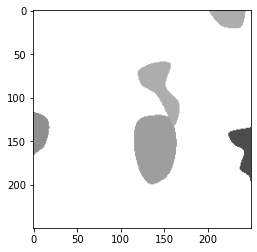

In [5]:
from PIL import Image
from collections import Counter
import matplotlib.image as mpimg
import matplotlib.pylab as plt
import numpy as np
#Label file
#210m/pixel

im = mpimg.imread("./MaskRCNNiceclassification/MaskSeg/IceBlocksOld/Europa_Ice_Blocks_A_B_1604_3061_0.png")
print(im.shape, im.dtype, type(im))  
plt.imshow(im*1)

In [4]:
from PIL import Image
Image.MAX_IMAGE_PIXELS = 1000000000 
from collections import Counter
import matplotlib.image as mpimg
import matplotlib.pylab as plt
import numpy as np
#Label file
#210m/pixel

im = mpimg.imread("./MaskRCNNiceclassification/MaskSeg/IceBlocksOld/Europa_Ice_Blocks_A_B_1604_3061_0.png")
print(im.shape, im.dtype, type(im))  

np.unique(im, return_counts=True)

(250, 250, 3) float32 <class 'numpy.ndarray'>


(array([0.3019608 , 0.56078434, 0.61960787, 0.6784314 , 1.        ],
       dtype=float32),
 array([  2412,   2076,   9450,   6774, 166788]))

In [7]:
np.unique(im)[:-1]

array([0.3019608 , 0.56078434, 0.61960787, 0.6784314 ], dtype=float32)

In [2]:
#Label file
#210m/pixel

im = mpimg.imread("./Monochromatic_Data/Europa_Ice_Blocks_Chaos_A_B_img.png")
print(im.shape, im.dtype, type(im))  

# im1 = im 
# im1[im1 > 0] = 1   
# plt.imshow(im1)
# plt.axis('off')
# plt.tight_layout()
#plt.imshow(im)


(14036, 22266, 3) float32 <class 'numpy.ndarray'>


array([0.        , 0.01176471, 0.01960784, 0.03137255, 0.03921569,
       0.05098039, 0.05882353, 0.07058824, 0.07843138, 0.09019608,
       0.10196079, 0.10980392, 0.12156863, 0.12941177, 0.14117648,
       0.14901961, 0.16078432, 0.16862746, 0.18039216, 0.1882353 ,
       0.2       , 0.21176471, 0.21960784, 0.23137255, 0.23921569,
       0.2509804 , 0.25882354, 0.27058825, 0.2784314 , 0.2901961 ,
       0.3019608 , 0.30980393, 0.32156864, 0.32941177, 0.34117648,
       0.34901962, 0.36078432, 0.36862746, 0.38039216, 0.3882353 ,
       0.4       , 0.4117647 , 0.41960785, 0.43137255, 0.4392157 ,
       0.4509804 , 0.45882353, 0.47058824, 0.47843137, 0.49019608,
       0.5019608 , 0.50980395, 0.52156866, 0.5294118 , 0.5411765 ,
       0.54901963, 0.56078434, 0.5686275 , 0.5803922 , 0.5882353 ,
       0.6       , 0.6117647 , 0.61960787, 0.6313726 , 0.6392157 ,
       0.6509804 , 0.65882355, 0.67058825, 0.6784314 , 0.6901961 ,
       0.7019608 , 0.70980394, 0.72156864, 0.7294118 , 0.74117

## Ice Block Finder: Instance Segmentation (Optional)

In [22]:
import os
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np

in_dir_lbl = './MaskRCNNiceclassification/MaskSeg/IceBlocksOld/'

def assignIceBlock(m,curval,q,x):
    while len(q) > 0:
        i,j = q.pop()
        if i >=0 and j >= 0 and i<len(m) and j < len(m[0]) and m[i,j] == x:
            m[i,j] = curval
            for x in [-1,1]:
                q.append((i+x,j))
                q.append((i,j+x))


def enumerateIceBlocks(m):
    curval = 256
    list_1 = list(np.unique(m)) 
    #list_1.remove(1)
    for x in list_1:
        curval+=1
        for i in range(len(m)):
            for j in range(len(m[0])):
                if m[i,j] == x:
                    assignIceBlock(m,curval,[(i,j)],x)
                    
    return m



for filename in os.listdir(in_dir_lbl):
    if filename.endswith(".png"):        
        lbl = np.array(Image.open('{}{}'.format(in_dir_lbl,filename))).astype('float64') # Could be problematic   
        #lbl=lbl[:,:,0]
        new = enumerateIceBlocks(lbl)
        plt.imsave(f"./InstanceSeg/MaskSeg/train/{filename}",new)
print("Done!")

Done!


In [ ]:
# import os
# import matplotlib.image as mpimg
# import matplotlib.pyplot as plt
# import numpy as np

# in_dir_lbl = './MaskRCNNiceclassification/MaskSeg/IceBlocksTest/'

# def assignIceBlock(m,curval,q,x):
#     while len(q) > 0:
#         i,j = q.pop()
#         if i >=0 and j >= 0 and i<len(m) and j < len(m) and m[i,j] == x:
#             m[i,j] = curval
#             for x in [-1,1]:
#                 q.append((i+x,j))
#                 q.append((i,j+x))


# def enumerateIceBlocks(m):
#     curval = 256
#     list_1 = list(np.unique(m)) 
#     #list_1.remove(1)
#     for x in list_1[:-1]:
#         for i in range(len(m)):
#             for j in range(len(m[0])):
#                 if m[i,j] == 255:
#                     assignIceBlocks(m,0,[(i,j)],)
#         curval+=1
#         for i in range(len(m)):
#             for j in range(len(m)):
#                 if m[i,j] == x:
#                     assignIceBlock(m,curval,[(i,j)],x)
                    
#     return m



# for filename in os.listdir(in_dir_lbl):
#     if filename.endswith(".png"):        
#         lbl = np.array(Image.open('{}{}'.format(in_dir_lbl,filename))).astype("float64")   
#         #lbl=lbl[:,:,0]
#         new = enumerateIceBlocks(lbl)
#         plt.imsave(f"./InstanceSeg/MaskSeg/test/{filename}",new)
# print("Done!")

## Random Crop Split Code

In [3]:
import numpy as np
from PIL import Image
import cv2
import os
import torchvision.transforms as T

def get_random_crop(img_dir_in, lbl_dir_in, img_dir_out, lbl_dir_out, crop_height, crop_width, count, train=False):
    """
    Input: files, directory containing raw images, directory containing raw labels, image & label output directories, desired crop height & width
    Output: randomly cropped images only containing ice blocks
    """
    for fn in os.listdir(img_dir_in):
        if fn.endswith(".png"): 
            cnt=0
            img = np.array(Image.open(os.path.join(img_dir_in, fn)))
            lbl = np.array(Image.open(os.path.join(lbl_dir_in, fn)))
            name, ext = os.path.splitext(fn)
            max_x = img.shape[0] - crop_width
            max_y = img.shape[1] - crop_height
            #print('Processing:',fn)
            while cnt<count:
                x = np.random.randint(0, max_x)
                y = np.random.randint(0, max_y)
                img_crop = img[x: x + crop_height, y: y + crop_width]
                lbl_crop = lbl[x: x + crop_height, y: y + crop_width]
                obj_ids = np.unique(lbl_crop)
                rand = np.random.ranf(1)
                rand2 = np.random.ranf(1)
                rand3 = np.random.ranf(1)
                rand4 = np.random.ranf(1)
                rand5 = np.random.ranf(1)
                if len(obj_ids)>3: # Assures that there is at least 1 ice block in an image (bugs out sometimes if there is only 1 ice block)
                    Image.fromarray(img_crop).save(f'{img_dir_out}{name}_{x}_{y}_{cnt}.png',"PNG")
                    Image.fromarray(lbl_crop).save(f'{lbl_dir_out}{name}_{x}_{y}_{cnt}.png',"PNG")
                    if train==True:
                        if rand >= 0.51:
                            blurrer = T.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5))
                            img_blur = blurrer(Image.fromarray(img_crop))
                            img_blur.save(f'{img_dir_out}{name}_{x}_{y}_{cnt}.png',"PNG")
                        if rand2 >= 0.51:
                            inverter = T.RandomInvert()
                            img_invert = inverter(Image.fromarray(img_crop))
                            img_invert.save(f'{img_dir_out}{name}_{x}_{y}_{cnt}.png',"PNG")
                        if rand3 >= 0.51:
                            solarizer = T.RandomSolarize(threshold=192.0)
                            img_solar = solarizer(Image.fromarray(img_crop))
                            img_solar.save(f'{img_dir_out}{name}_{x}_{y}_{cnt}.png',"PNG") 
                        if rand4 >= 0.51:
                            sharpness_adjuster = T.RandomAdjustSharpness(sharpness_factor=2)
                            img_sharp = sharpness_adjuster(Image.fromarray(img_crop))
                            img_sharp.save(f'{img_dir_out}{name}_{x}_{y}_{cnt}.png',"PNG") 
                        if rand5 >= 0.51:
                            autocontraster = T.RandomAutocontrast()
                            img_contrast = autocontraster(Image.fromarray(img_crop))
                            img_contrast.save(f'{img_dir_out}{name}_{x}_{y}_{cnt}.png',"PNG")     
                    cnt+=1

In [4]:
get_random_crop("./LabelMe_files/PNG RegMaps/data_annotated/train/",
                './LabelMe_files/PNG RegMaps/data_dataset_voc/SegmentationObjectPNG/train/',
                "./InstanceSeg/ImageSeg/train/",'./InstanceSeg/MaskSeg/train/', 250, 250, 200, train=True)

In [5]:
get_random_crop("./LabelMe_files/PNG RegMaps/data_annotated/val/",
                './LabelMe_files/PNG RegMaps/data_dataset_voc/SegmentationObjectPNG/val/',
                "./InstanceSeg/ImageSeg/val/",'./InstanceSeg/MaskSeg/val/', 250, 250, 25, train=False)

In [3]:
lbl = np.array(Image.open('./ArcGIS_Pro_Labels/LabeledObjects/E6ESDRKLIN01_GalileoSSI_E_png/202301310920206663987/bad_labels/000000000018.png'))
np.unique(lbl, return_counts=True)

(array([0], dtype=uint8), array([196608]))

In [144]:
for x in range(len(np.unique(lbl))):
    lbl[lbl==np.unique(lbl)[x]] = x

np.unique(lbl,return_counts=True)
    

(array([0], dtype=uint8), array([262144]))

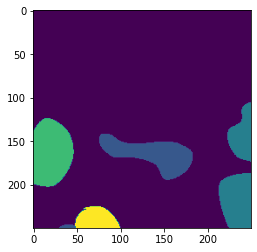

In [57]:
#im = mpimg.imread("./MaskRCNNiceclassification/MaskSeg/IceBlocksOld/Europa_Ice_Blocks_A_B_1604_3061_0.png")
#print(i.shape, im.dtype, type(im))  
plt.imshow(lbl)

### Dataset Visualization (Optional)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


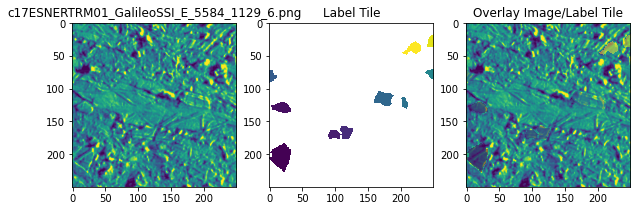

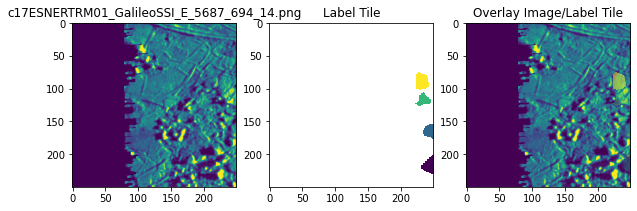

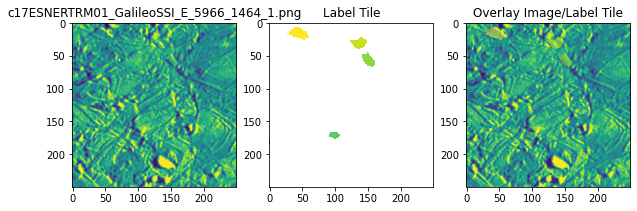

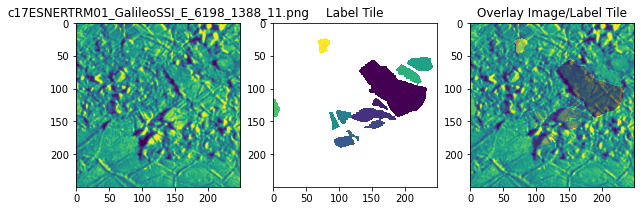

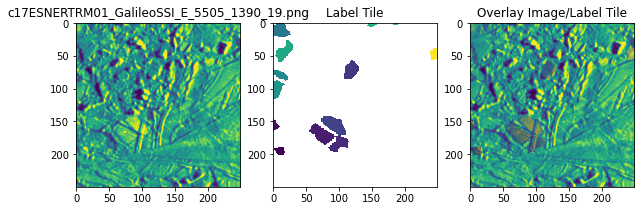

...

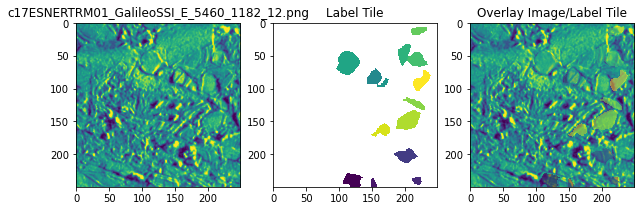

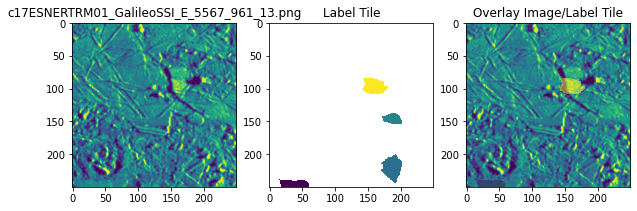

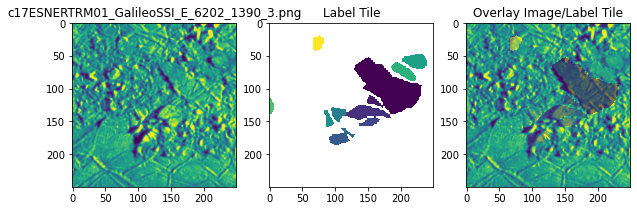

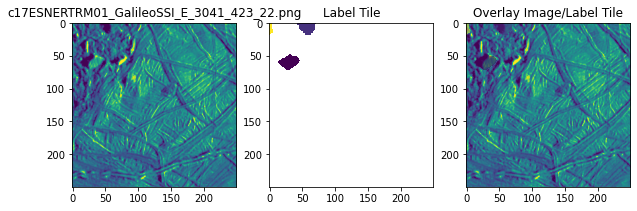

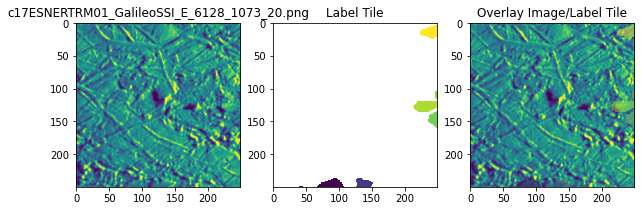

In [6]:
import os
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
in_dir_img = './InstanceSeg/ImageSeg/val/'
in_dir = './InstanceSeg/MaskSeg/val/'
for filename in os.listdir(in_dir_img):
    if filename.endswith(".png"):
        # Why is this green?!
        lbl = np.array(Image.open('{}{}'.format(in_dir,filename)))
        img = np.array(Image.open('{}{}'.format(in_dir_img,filename)))
        lbl = np.ma.masked_where(lbl == 0, lbl)
        fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(10, 10))
        ax1.imshow(img)
        ax1.set_title(f'{filename}')
        ax2.imshow(lbl)
        ax2.set_title("Label Tile")
        ax3.imshow(img)
        ax3.imshow(lbl, alpha = 0.5)
        ax3.set_title("Overlay Image/Label Tile")

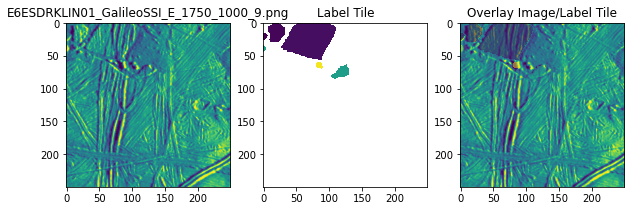

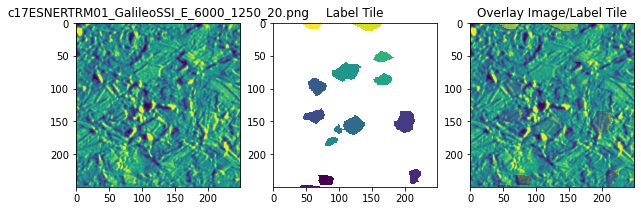

In [9]:
import os
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
in_dir_img = './InstanceSeg/ImageSeg/test/'
in_dir = './InstanceSeg/MaskSeg/test/'
for filename in os.listdir(in_dir):
    if filename.endswith(".png"):
        # Why is this green?!
        lbl = np.array(Image.open('{}{}'.format(in_dir,filename)))
        img = np.array(Image.open('{}{}'.format(in_dir_img,filename)))
        lbl = np.ma.masked_where(lbl == 0, lbl)
        fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(10, 10))
        ax1.imshow(img)
        ax1.set_title(f'{filename}')
        ax2.imshow(lbl)
        ax2.set_title("Label Tile")
        ax3.imshow(img)
        ax3.imshow(lbl, alpha = 0.5)
        ax3.set_title("Overlay Image/Label Tile")

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


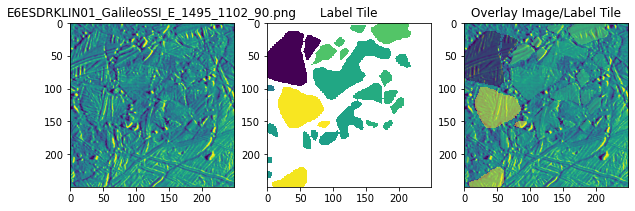

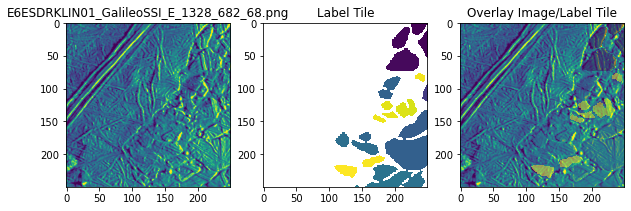

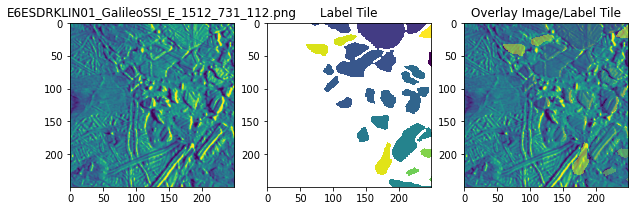

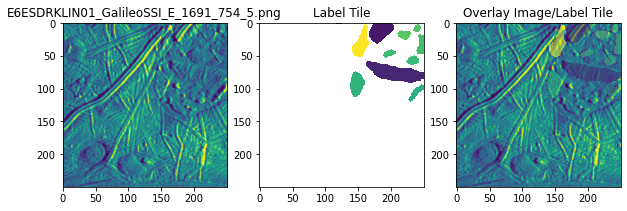

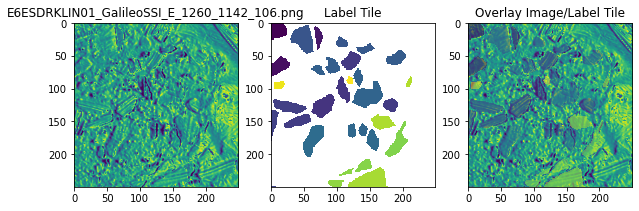

...

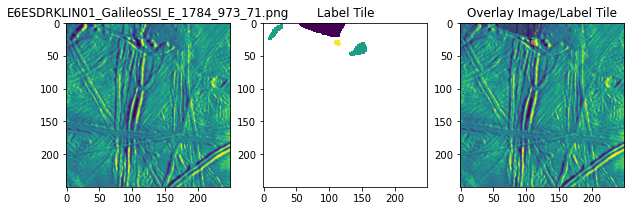

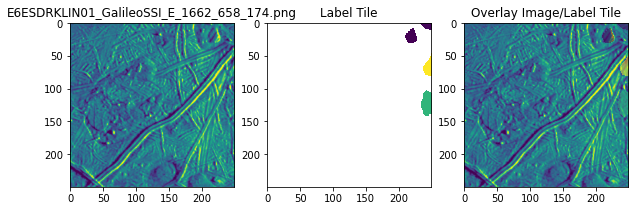

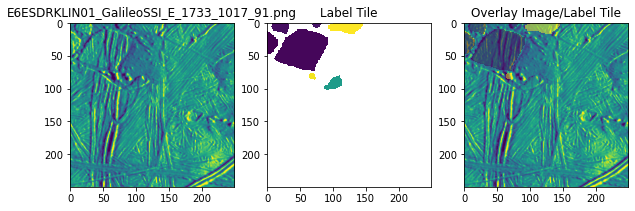

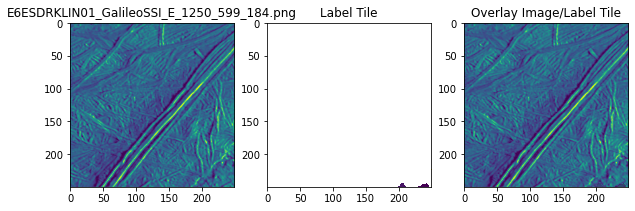

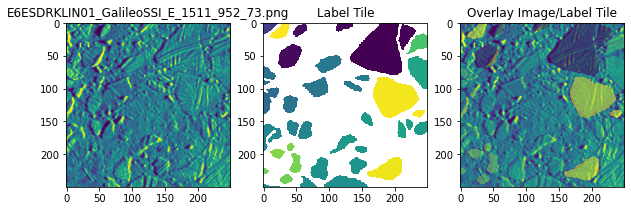

In [ ]:
import os
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
in_dir_img = './InstanceSeg/ImageSeg/train/'
in_dir = './InstanceSeg/MaskSeg/train/'
for filename in os.listdir(in_dir):
    if filename.endswith(".png"):
        # Why is this green?!
        lbl = np.array(Image.open('{}{}'.format(in_dir,filename)))
        img = np.array(Image.open('{}{}'.format(in_dir_img,filename)))
        lbl = np.ma.masked_where(lbl == 0, lbl)
        fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(10, 10))
        ax1.imshow(img)
        ax1.set_title(f'{filename}')
        ax2.imshow(lbl)
        ax2.set_title("Label Tile")
        ax3.imshow(img)
        ax3.imshow(lbl, alpha = 0.5)
        ax3.set_title("Overlay Image/Label Tile")

# Sandbox Code (DO NOT RUN!)

### 1st Attempt (Labels Every Pixel as a Different number)

In [23]:
import pdb
import numpy as np
from itertools import product
mat = np.zeros((10,10))
for i in range(2,5):
    for j in range(2,5):
        mat[i][j] = 1
for i in range(8,10):
    for j in range(8,10):
        mat[i][j] = 1

def search_local(x,y):
    pairs = product([-1,0,1],[-1,0,1])
    ret = []
    for pair in pairs:
        x+=pair[0]
        y+=pair[1]
        if mat[x,y]==1:
            ret.append(pair)
    return ret

current_color = 1
all_blocks = list(zip(*np.where(mat==1)))
while all_blocks:
    print("all blocks:",all_blocks)
    current_color+=1
    current_que = [all_blocks[0]]
    while current_que:
        print('current_que',current_que)
        x, y = current_que.pop(0)
        _ = all_blocks.pop(all_blocks.index((x,y)))
        mat[x,y] = current_color
        new_locs = search_local(x,y)
        pdb
        for loc in new_locs:
            print('new_locs', new_locs)
            if loc not in current_que:
                current_que.append(loc)


all blocks: [(2, 2), (2, 3), (2, 4), (3, 2), (3, 3), (3, 4), (4, 2), (4, 3), (4, 4), (8, 8), (8, 9), (9, 8), (9, 9)]
current_que [(2, 2)]
all blocks: [(2, 3), (2, 4), (3, 2), (3, 3), (3, 4), (4, 2), (4, 3), (4, 4), (8, 8), (8, 9), (9, 8), (9, 9)]
current_que [(2, 3)]
all blocks: [(2, 4), (3, 2), (3, 3), (3, 4), (4, 2), (4, 3), (4, 4), (8, 8), (8, 9), (9, 8), (9, 9)]
current_que [(2, 4)]
all blocks: [(3, 2), (3, 3), (3, 4), (4, 2), (4, 3), (4, 4), (8, 8), (8, 9), (9, 8), (9, 9)]
current_que [(3, 2)]
all blocks: [(3, 3), (3, 4), (4, 2), (4, 3), (4, 4), (8, 8), (8, 9), (9, 8), (9, 9)]
current_que [(3, 3)]
all blocks: [(3, 4), (4, 2), (4, 3), (4, 4), (8, 8), (8, 9), (9, 8), (9, 9)]
current_que [(3, 4)]
all blocks: [(4, 2), (4, 3), (4, 4), (8, 8), (8, 9), (9, 8), (9, 9)]
current_que [(4, 2)]
all blocks: [(4, 3), (4, 4), (8, 8), (8, 9), (9, 8), (9, 9)]
current_que [(4, 3)]
all blocks: [(4, 4), (8, 8), (8, 9), (9, 8), (9, 9)]
current_que [(4, 4)]
all blocks: [(8, 8), (8, 9), (9, 8), (9, 9)]
c

In [24]:
mat

array([[ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  2.,  3.,  4.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  5.,  6.,  7.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  8.,  9., 10.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 11., 12.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 13., 14.]])

### 2nd Attempt (Getting Each Ice Block the Same Number)

In [29]:
import numpy as np
from itertools import product
mat = np.zeros((10,10,3))
for i in range(2,5):
    for j in range(2,5):
        mat[i][j][0] = 1
for i in range(8,10):
    for j in range(8,10):
        mat[i][j][0] = 1
mat

array([[[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
  

In [68]:
import numpy as np
from itertools import product
mat = np.zeros((10,10,3))
for i in range(2,5):
    for j in range(2,5):
        mat[i][j][0] = 1
for i in range(8,10):
    for j in range(8,10):
        mat[i][j][0] = 1
        
# mat[3][3]=0
# mat[2][3]=0
# mat[2][4]=0

def search_local(x,y,z):
    pairs = product([-1,0,1],[-1,0,1],[0])
    ret = []
    for pair in pairs:
        if x+pair[0]<len(mat) and y+pair[1]<len(mat):
            if x+pair[0]>0 and y+pair[1]>0:
                if mat[x+pair[0],y+pair[1],z+pair[2]]==1:
                    ret.append([x+pair[0],y+pair[1],z+pair[2]])
    return ret

current_color = 1
all_blocks = list(zip(*np.where(mat==1)))
while all_blocks:
    #print('all',all_blocks)
    current_color+=1
    current_que = [all_blocks[0]]
    print(current_que)
    while current_que:
        #print(current_que)
        x, y, z = current_que.pop()
        _ = all_blocks.pop(all_blocks.index((x,y,z)))
        mat[x,y,z] = current_color
        new_locs = search_local(x,y,z)
        #print('new',new_locs)
        for loc in new_locs:
            #print(new_locs)
            if loc not in current_que:
                current_que.append(loc)

[(2, 2, 0)]
[(8, 8, 0)]


In [69]:
mat

array([[[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [2., 0., 0.],
        [2., 0., 0.],
        [2., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [2., 0., 0.],
        [2., 0., 0.],
        [2., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [2., 0., 0.],
        [2., 0., 0.],
        [2., 0., 0.],
  

In [ ]:
# import os
# import matplotlib.image as mpimg
# import matplotlib.pyplot as plt
# import numpy as np

# in_dir_lbl = './MaskRCNNiceclassification/MaskSeg/IceBlocksOld/'

# def assignIceBlock(m,curval,q):
#     color_id = m[q[0][0], q[0][1]] # Identifies the apporpriate color to target
#     while len(q) > 0: # While que is not empty, que is not empty on initialization
#         i,j = q.pop() # Pulls a possible location from the que
#         if i >=0 and j >= 0 and i<len(m) and j < len(m[0]) and m[i,j] == color_id: # Insures i and j are inside the boundaries and target = entry value
#             m[i,j] = curval # Updates matrix m with current value
#             for x in [-1,1]: 
#                 q.append((i+x,j)) # Looks to the left/right
#                 q.append((i,j+x)) # Looks up/down


# def enumerateIceBlocks(m):
#     curval = 2
#     for i in range(len(m)):
#         for j in range(len(m[0])):
#             #import pdb; pdb.set_trace()
#             if m[i,j][0]%1 == 0:
#                 assignIceBlock(m,curval,[(i,j)])
#                 curval+=1
#     return m


# filename = "Europa_Ice_Blocks_A_B_1032_2294_12.png"
# # for filename in os.listdir(in_dir_lbl):
# #     if filename.endswith(".png"):
#         #print("Processing:", filename)
# lbl = mpimg.imread('{}{}'.format(in_dir_lbl,filename))   
# # lbl=lbl[:,:,0]
# # lbl[lbl!=0]=5
# # lbl[lbl==0]=1
# # lbl[lbl==5]=0
# new = enumerateIceBlocks(lbl)

#         #plt.imsave(f"./InstanceSeg/MaskSeg/train/{filename}",new)
# print("Done!")
# plt.imshow(new)

In [ ]:
# import numpy as np
# from PIL import Image
# import cv2
# import os

# def get_random_crop(img_dir_in, lbl_dir_in, img_dir_out, lbl_dir_out, crop_height, crop_width, count):
#     """
#     Input: files, directory containing raw images, directory containing raw labels, image & label output directories, desired crop height & width
#     Output: randomly cropped images only containing ice blocks
#     """
#     for fn in os.listdir(img_dir_in):
#         if fn.endswith(".png"): 
#             cnt=0
#             img = np.array(Image.open(os.path.join(img_dir_in, fn)))
#             lbl = np.array(Image.open(os.path.join(lbl_dir_in, fn)))
#             name, ext = os.path.splitext(fn)
#             max_x = img.shape[0] - crop_width
#             max_y = img.shape[1] - crop_height
#             print('Processing:',fn)
#             while cnt<count:
#                 x = np.random.randint(0, max_x)
#                 y = np.random.randint(0, max_y)
#                 img_crop = img[x: x + crop_height, y: y + crop_width]
#                 lbl_crop = lbl[x: x + crop_height, y: y + crop_width]
#                 obj_ids = np.unique(lbl_crop)
#                 if len(obj_ids)>1: # Assures that there is at least 1 ice block in an image (bugs out sometimes if there is only 1 ice block)
#                     Image.fromarray(img_crop).save(f'{img_dir_out}{name}_{x}_{y}_{cnt}.png',"PNG")
#                     Image.fromarray(lbl_crop).save(f'{lbl_dir_out}{name}_{x}_{y}_{cnt}.png',"PNG")
#                     cnt+=1